## Utilizzo dell'equazione di Penman-Monteith per il calcolo dell'evapotraspirazione

L'utilizzo del modello di Penman-Monteith per il calcolo dell'evapotraspirazione prevede la risoluzione dell'equazione:
\begin{equation}
\lambda\ ET = \dfrac{\Delta\cdot (R_{n} - G)+\frac{p_{a}\cdot\ c_{p}(e_{s}-e)}{r_{a}}}{\Delta+\gamma\cdot(1+\frac{r_{s}}{r_{a}})}
\end{equation}

La FAO (Organizzazione delle Nazioni Unite per l'Ambiente e l'Agricoltura) ha inoltre introdotto una formulazione che tenga conto anche dei fenomeni di stress e in particolare del termine $kc$, dovuto alla vegetazione, e $ks$, coefficiente che tiene invece conto del contenuto di acqua nel suolo.

In questo caso la relazione diventa:
\begin{equation}
ET_{0}^{FAO} =  K_{s} \cdot K_{c} \cdot \dfrac{0.408\cdot \Delta\cdot (R_{n} - G)+\gamma\cdot u_{2}\cdot(e_{s}-e)\cdot\frac{C_{p}}{T+273}}{\Delta+\gamma\cdot(1+C_{d}\cdot u_{2})}
\end{equation}

Un altro temine importante presente nella formula è $G$, il flusso di calore al suolo, che prende valori diversi per la notte e per il giorno.

Per questa simulazione è stata presa in considerazione una foresta di conifere situata in prossimità del centroide per la stazione di Cavone. L'altezza stimata per questo tipo di vegetazione è di 10m, la massima profondità delle radici è di 1.0 - 1.5m così come riportato nelle tabelle della FAO.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image
import plotly.express as px
import plotly.graph_objects as go
import os
from GEOSPACE_Output import*

In [2]:
oms_project_path = os.path.dirname(os.getcwd())
os.chdir(oms_project_path+'/output/Cavone/1')

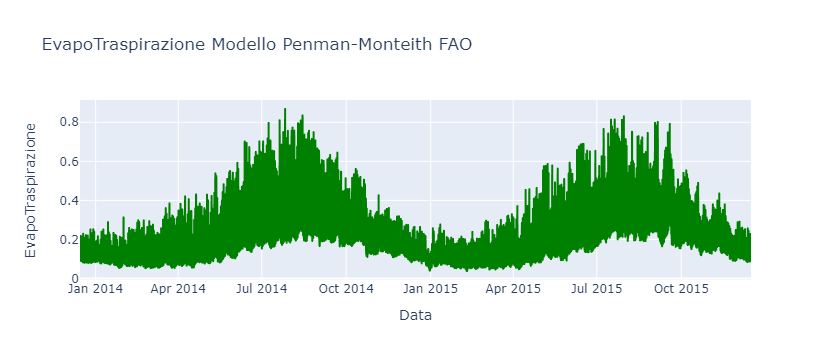

In [3]:
df = pd.read_csv('ET_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df.columns = ['Data','EvapoTraspirazione']
fig = px.line(df, x='Data', y='EvapoTraspirazione', title='EvapoTraspirazione Modello Penman-Monteith FAO')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()


Come si può osservare dal grafico l'andamento dell'Evapotraspirazione secondo il modello di Penman-Monteith prende valori molto variabili a seconda della stagione per quello che riguarda un eventuale conifera posizionata in prossimità di Cavone, con degli evidenti minimi in Inverno

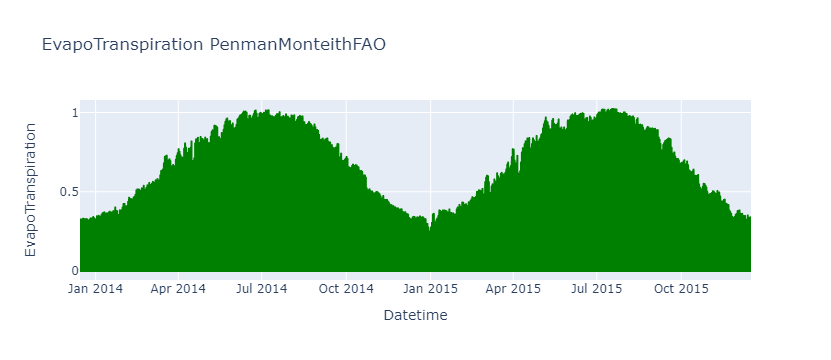

In [4]:
# file Emma =

df1 = pd.read_csv('Evapotranspiration_PT_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df1.columns = ['Datetime','EvapoTranspiration']
fig = px.line(df1, x='Datetime', y='EvapoTranspiration', title='EvapoTranspiration PenmanMonteithFAO')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

é poi possibile rappresentare con anche il calore latente, confrontando nuovamente i risultati ottenuti col modello della FAO e quelli con Priestley-Taylor:

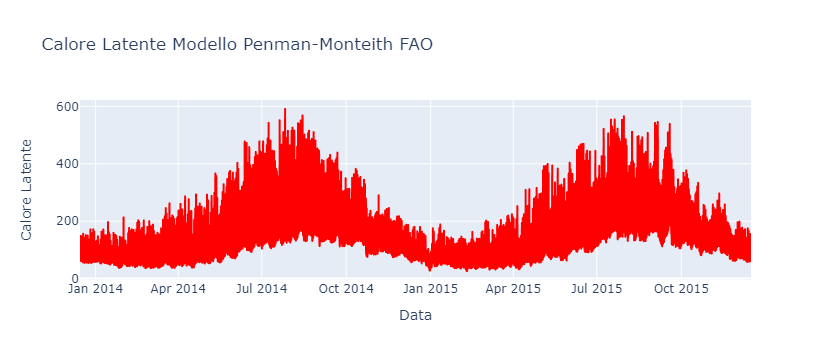

In [5]:
df2 = pd.read_csv('LH_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df2.columns = ['Data','Calore Latente']
fig = px.line(df2, x='Data', y='Calore Latente', title='Calore Latente Modello Penman-Monteith FAO')
fig.update_traces(line_color='red')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

L'andamento del calore latente (espresso in J/m^2) segue quello che è già stato osservato per l'evapotraspirazione.

La trattazione continua considerando poi non solo i valori di Evapotraspirazione in condizioni ottimali, ma quelli che effettivamente si trovano a causa del contenuto d'acqua nel suolo, di fattori ambientali vari o semplicemente della vegetazione presente.
Si fanno, quindi, più esempi per osservare come si modificano i risultati prendendo in considerazione ad esempio il solo termine di stress dovuto al contenuto di acqua nel suolo, tenendo conto di quello dovuto a varie condizioni ambientali (come lo stress dovuto alla radiazione, il Vapure Pressure Deficit o la temperatura) e infine considerando tutti questi fattori contemporaneamente.

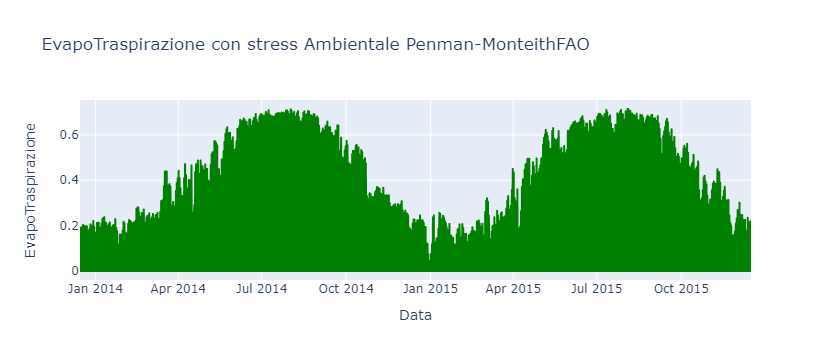

In [6]:
df3 = pd.read_csv('env_ET_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df3.columns = ['Data','EvapoTraspirazione']
fig = px.line(df3, x='Data', y='EvapoTraspirazione', title='EvapoTraspirazione con stress Ambientale Penman-MonteithFAO')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Tenendo conto anche solo dello stress dovuto a fenomeni ambientali l'evapotraspirazione passa da un massimo di 0.8mm a un massimo di 0.6mm.
La differenza risulta ancora più importante se teniamo conto anche dello stress idrico nel calcolo dell'evapotraspirazione, come si può osservare dai seguenti grafici:

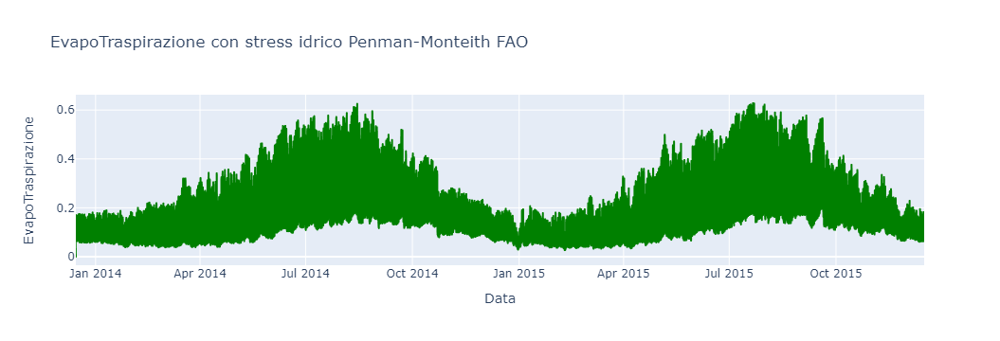

In [7]:
df4 = pd.read_csv('wat_ET_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Data','EvapoTraspirazione']
fig = px.line(df4, x='Data', y='EvapoTraspirazione', title='EvapoTraspirazione con stress idrico Penman-Monteith FAO')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Teniamo poi conto di tutti i fattori che possono influenzare l'Evapotraspirazione contemporaneamente e notiamo una netta diminuzione rispetto ai valori iniziali:

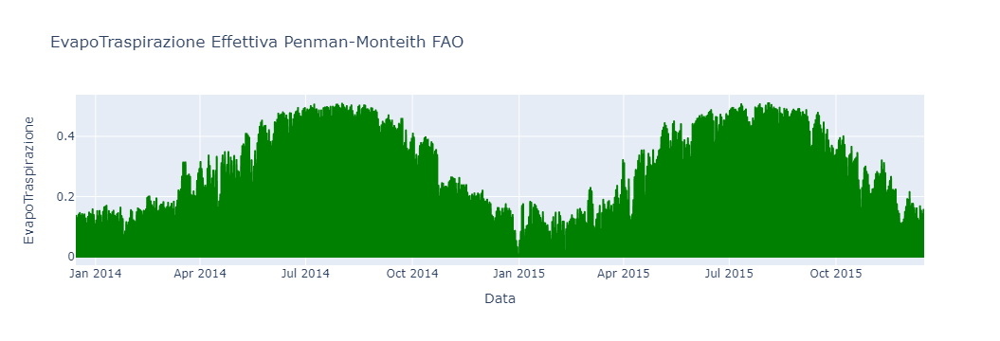

In [9]:
df5 = pd.read_csv('tot_ET_FAO_1.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df5.columns = ['Data','EvapoTraspirazione']
fig = px.line(df5, x='Data', y='EvapoTraspirazione', title='EvapoTraspirazione Effettiva Penman-Monteith FAO')
fig.update_traces(line_color='green')
#fig.update_xaxes(rangeslider_visible=True)
fig.show()

Per visualizzare i risultati in modo più chiaro confrontiamo prima i risultati dell'Evapotraspirazione calcolata con Priestley-Taylor e quella calcolata con Penman Monteith in assenza di stress e in presenza di tutti gli stress:

In [ ]:
#non eseguire, manca PT!!!!!!

fig = px.line()
fig.add_trace(go.Scatter(x=df1['Data'], y=df1['EvapoTraspirazione'], mode='lines', name='ET PT'))
fig.add_trace(go.Scatter(x=df['Data'], y=df['EvapoTraspirazione'], mode='lines', name='ET PM'))
fig.add_trace(go.Scatter(x=df3['Data'], y=df5['EvapoTraspirazione'], mode='lines', name='ET PM Actual'))

fig.update_layout(
    title='Confronto EvapoTraspirazione PM e PT ',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="EvapoTraspirazione [mm]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

In [ ]:
Confrontiamo in fine i risultati ottenuti con Penman-Monteith in assenza e in presenza dei vari tipi di stress

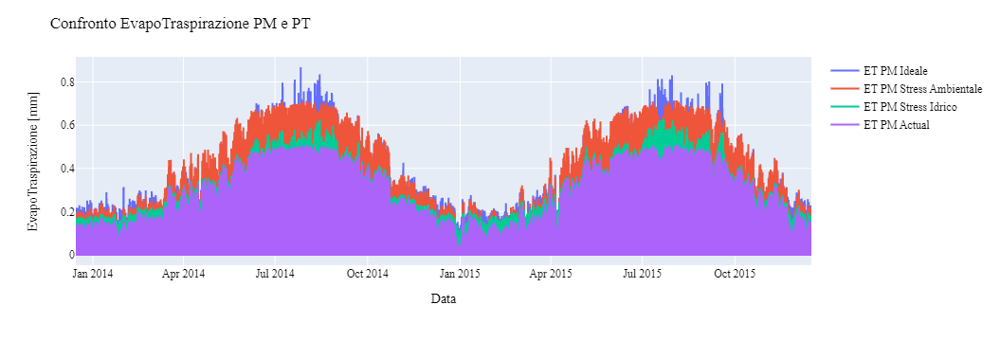

In [10]:
fig = px.line()
fig.add_trace(go.Scatter(x=df['Data'], y=df['EvapoTraspirazione'], mode='lines', name='ET PM Ideale'))
fig.add_trace(go.Scatter(x=df3['Data'], y=df3['EvapoTraspirazione'], mode='lines', name='ET PM Stress Ambientale'))
fig.add_trace(go.Scatter(x=df4['Data'], y=df4['EvapoTraspirazione'], mode='lines', name='ET PM Stress Idrico'))
fig.add_trace(go.Scatter(x=df3['Data'], y=df5['EvapoTraspirazione'], mode='lines', name='ET PM Actual'))

fig.update_layout(
    title='Confronto EvapoTraspirazione PM e PT ',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="EvapoTraspirazione [mm]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()